In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !git clone https://github.com/facebookresearch/detectron2 detectron2_repo
# !pip install -e detectron2_repo

In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'
# !cp -r /usr/local/lib/python3.10/dist-packages/detectron2 /content/drive/MyDrive/

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-u0oifbs3
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-u0oifbs3
  Resolved https://github.com/facebookresearch/detectron2.git to commit 536dc9d527074e3b15df5f6677ffe1f4e104a4ab
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 3.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.3/81.3 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 13.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 16.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 58.3 MB/s eta 0:00:00
  Created wheel for detectron2: filename=detectron2-0.6-cp311

In [ ]:
import detectron2
from google.colab.patches import cv2_imshow

In [ ]:
import detectron2
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode

import os
import json
import cv2
import numpy as np
from glob import glob
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.structures import BoxMode
from sklearn.model_selection import train_test_split

In [ ]:
# Paths
kitti_json_path = "/content/drive/MyDrive/Colab Notebooks/training/update_train_2020.json"
kitti_image_folder = "/content/drive/MyDrive/Colab Notebooks/training/image_2"

# Load KITTI Annotations
with open(kitti_json_path) as f:
    kitti_data = json.load(f)

# Extract KITTI images and annotations
kitti_annotations = [ann for ann in kitti_data['annotations'] if ann['category_id'] == 4]
kitti_image_ids = {ann['image_id'] for ann in kitti_annotations}
kitti_images = [img for img in kitti_data['images'] if img['id'] in kitti_image_ids]

# Convert KITTI annotations
kitti_dataset = []
for img in kitti_images:
    record = {
        "file_name": os.path.join(kitti_image_folder, img["file_name"]),
        "image_id": img["id"],
        "height": img["height"],
        "width": img["width"],
        "annotations": []
    }
    for ann in [a for a in kitti_annotations if a["image_id"] == img["id"]]:
        poly = [p for x in ann["a_segm"] for p in x]
        obj = {
            "bbox": [np.min(poly[::2]), np.min(poly[1::2]), np.max(poly[::2]), np.max(poly[1::2])],
            "bbox_mode": BoxMode.XYXY_ABS,
            "segmentation": [poly],
            "category_id": 0,
        }
        record["annotations"].append(obj)
    kitti_dataset.append(record)


In [ ]:
# Load Synthetic Annotations

synthetic_json_folder = "/content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/Mask_ann2"
synthetic_image_folder = "/content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic"

synthetic_json_files = glob(os.path.join(synthetic_json_folder, "*.json"))
synthetic_dataset = []
count = 0

for json_file in synthetic_json_files:
    with open(json_file) as f:
        annotation_data = json.load(f)

    image_path = os.path.join(synthetic_image_folder, annotation_data["image_name"])
    if not os.path.exists(image_path):
        continue

    img = cv2.imread(image_path)
    if img is None:
        continue

    record = {
        "file_name": image_path,
        "image_id": len(synthetic_dataset) + len(kitti_dataset),
        "height": img.shape[0],
        "width": img.shape[1],
        "annotations": []
    }

    for obj in annotation_data["objects"]:
        if obj["classTitle"].lower() == "car":
            # Check if segmentation exists and is non-empty
            if "segmentation" not in obj or not obj["segmentation"]:
                count += 1
                continue

            # Flatten the segmentation points from list of segments
            poly = [p for seg in obj["segmentation"] for p in seg]
            if len(poly) < 6:
                continue

            obj_dict = {
                "bbox": [np.min(poly[::2]), np.min(poly[1::2]), np.max(poly[::2]), np.max(poly[1::2])],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
            }
            record["annotations"].append(obj_dict)

    # Skip the image if no valid car segmentation was found
    if not record["annotations"]:
        print(f"Skipping image {image_path} due to no valid segmentation.")
        continue

    synthetic_dataset.append(record)

# Merge Datasets
merged_dataset = kitti_dataset + synthetic_dataset

Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/676069.png due to no valid segmentation.
Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/01109.jpg due to no valid segmentation.
Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/01271.jpg due to no valid segmentation.


In [ ]:
# Load Synthetic Annotations

synthetic_json_folder = "/content/drive/MyDrive/Colab Notebooks/occl_synthetic_2/synthetic_combined.json"
synthetic_image_folder = "/content/drive/MyDrive/Colab Notebooks/occl_synthetic_2/Occlusion_synthetic 3"

synthetic_json_files = glob(os.path.join(synthetic_json_folder, "*.json"))
synthetic_dataset = []
count = 0

for json_file in synthetic_json_files:
    with open(json_file) as f:
        annotation_data = json.load(f)

    image_path = os.path.join(synthetic_image_folder, annotation_data["image_name"])
    if not os.path.exists(image_path):
        continue

    img = cv2.imread(image_path)
    if img is None:
        continue

    record = {
        "file_name": image_path,
        "image_id": len(synthetic_dataset) + len(kitti_dataset),
        "height": img.shape[0],
        "width": img.shape[1],
        "annotations": []
    }

    for obj in annotation_data["objects"]:
        if obj["classTitle"].lower() == "car":
            # Check if segmentation exists and is non-empty
            if "segmentation" not in obj or not obj["segmentation"]:
                count += 1
                continue

            # Flatten the segmentation points from list of segments
            poly = [p for seg in obj["segmentation"] for p in seg]
            if len(poly) < 6:
                continue

            obj_dict = {
                "bbox": [np.min(poly[::2]), np.min(poly[1::2]), np.max(poly[::2]), np.max(poly[1::2])],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
            }
            record["annotations"].append(obj_dict)

    # Skip the image if no valid car segmentation was found
    if not record["annotations"]:
        print(f"Skipping image {image_path} due to no valid segmentation.")
        continue

    synthetic_dataset.append(record)

# Merge Datasets
merged_dataset = kitti_dataset + synthetic_dataset

Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/Occlusion_synthetic 3/01109.jpg due to no valid segmentation.
Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/Occlusion_synthetic 3/02208.jpg due to no valid segmentation.
Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/Occlusion_synthetic 3/02675.jpg due to no valid segmentation.
Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/Occlusion_synthetic 3/02927.jpg due to no valid segmentation.
Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/Occlusion_synthetic 3/02766.jpg due to no valid segmentation.
Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/Occlusion_synthetic 3/01271.jpg due to no valid segmentation.
Skipping image /content/drive/MyDrive/Colab Notebooks/Occlusion_synthetic/Occlusion_synthetic 3/02292.jpg due to no valid segmentation.
Skipping image /content/drive/MyDrive/Colab Note

In [ ]:
import os
import json
import numpy as np
from detectron2.structures import BoxMode

# Paths to your new combined synthetic JSON and image folder
synthetic_json_path = "/content/drive/MyDrive/Colab Notebooks/occl_synthetic_2/synthetic_combined.json"
synthetic_image_folder = "/content/drive/MyDrive/Colab Notebooks/occl_synthetic_2/Occlusion_synthetic 3"

# Load combined synthetic JSON
with open(synthetic_json_path) as f:
    synthetic_data = json.load(f)

synthetic_dataset = []

for img_dict in synthetic_data["images"]:
    record = {
        "file_name": os.path.join(synthetic_image_folder, img_dict["file_name"]),
        "image_id": img_dict["id"] + len(kitti_dataset),  # Avoid ID clash
        "height": img_dict["height"],
        "width": img_dict["width"],
        "annotations": []
    }

    for ann in [a for a in synthetic_data["annotations"] if a["image_id"] == img_dict["id"]]:
        poly = ann["segmentation"][0]
        bbox = ann["bbox"]
        obj = {
            "bbox": [bbox[0], bbox[1], bbox[0] + bbox[2], bbox[1] + bbox[3]],
            "bbox_mode": BoxMode.XYXY_ABS,
            "segmentation": [poly],
            "category_id": ann["category_id"]
        }
        record["annotations"].append(obj)

    if record["annotations"]:
        synthetic_dataset.append(record)

# Merge with KITTI
merged_dataset = kitti_dataset + synthetic_dataset


In [ ]:
# Split Data into Train/Validation
syn_train_data, syn_val_data = train_test_split(synthetic_dataset, test_size=0.2, random_state=42)

# Register Merged Dataset in Detectron2
DatasetCatalog.register("synthetic_train", lambda: syn_train_data)
MetadataCatalog.get("synthetic_train").set(thing_classes=["car"])

DatasetCatalog.register("synthetic_val", lambda: syn_val_data)
MetadataCatalog.get("synthetic_val").set(thing_classes=["car"])

namespace(name='synthetic_val', thing_classes=['car'])

In [ ]:
print(len(kitti_dataset))

6990


In [ ]:
print(len(synthetic_dataset))

6516


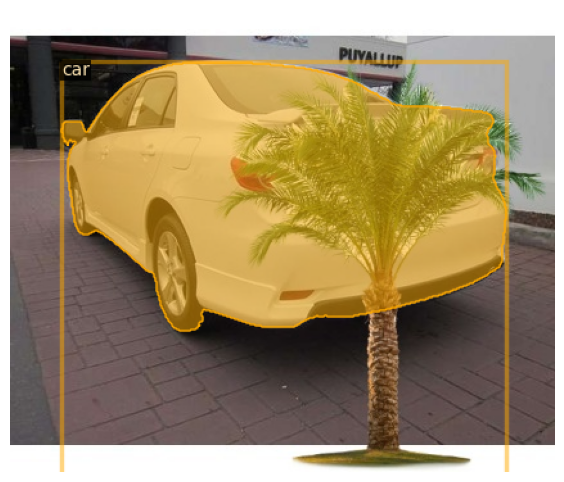

In [ ]:
import cv2
import random
import matplotlib.pyplot as plt
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Load dataset
dataset_dicts = DatasetCatalog.get("synthetic_train")
metadata = MetadataCatalog.get("synthetic_train")

# Pick a random image
sample = random.choice(dataset_dicts)
img = cv2.imread(sample["file_name"])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB

# Visualize annotations
visualizer = Visualizer(img, metadata=metadata, scale=1.0)
out = visualizer.draw_dataset_dict(sample)

# Show the image
plt.figure(figsize=(8, 6))
plt.imshow(out.get_image())
plt.axis("off")
plt.show()


In [ ]:
# Split Data into Train/Validation
train_data, val_data = train_test_split(merged_dataset, test_size=0.2, random_state=42)

# Register Merged Dataset in Detectron2
DatasetCatalog.register("merged_train2", lambda: train_data)
MetadataCatalog.get("merged_train2").set(thing_classes=["car"])

DatasetCatalog.register("merged_val2", lambda: val_data)
MetadataCatalog.get("merged_val2").set(thing_classes=["car"])

namespace(name='merged_val2', thing_classes=['car'])

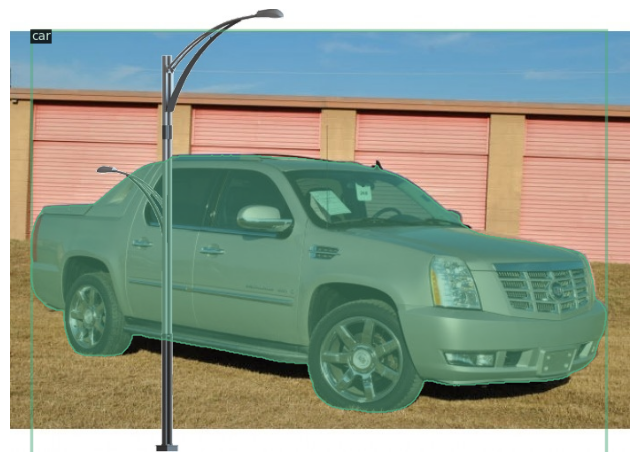

In [ ]:
import cv2
import random
import matplotlib.pyplot as plt
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Load dataset
dataset_dicts = DatasetCatalog.get("merged_train2")
metadata = MetadataCatalog.get("merged_train2")

# Pick a random image
sample = random.choice(dataset_dicts)
img = cv2.imread(sample["file_name"])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB

# Visualize annotations
visualizer = Visualizer(img, metadata=metadata, scale=1.0)
out = visualizer.draw_dataset_dict(sample)

# Show the image
plt.figure(figsize=(8, 6))
plt.imshow(out.get_image())
plt.axis("off")
plt.show()


In [ ]:
import os

missing_files = []
for data in dataset_dicts[:10]:  # Check first 10 images
    file_path = data["file_name"]
    if not os.path.exists(file_path):
        missing_files.append(file_path)

if missing_files:
    print("Missing images:", missing_files)
else:
    print("All images are correctly linked.")


NameError: name 'dataset_dicts' is not defined

In [ ]:
import torch
import cv2

Change Output


In [ ]:
import torch
import os
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

# Create a configuration object
cfg = get_cfg()

# Set output directory
cfg.OUTPUT_DIR = "/content/drive/MyDrive/Colab Notebooks/output 7"

# Check for GPU availability
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# Load COCO-pretrained Mask R-CNN model
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))

# Use the merged dataset
cfg.DATASETS.TRAIN = ("merged_train2",)
cfg.DATASETS.TEST = ("merged_val2",)

# Set number of data workers
cfg.DATALOADER.NUM_WORKERS = 2

# Load COCO-pretrained weights
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("Cityscapes/mask_rcnn_R_50_FPN.yaml")
# cfg.MODEL.WEIGHTS = "/content/model_final_f10217.pkl"

# Training hyperparameters
cfg.SOLVER.IMS_PER_BATCH = 1 # Increase if GPU memory allows
cfg.SOLVER.BASE_LR = 0.0001   # Lower LR for fine-tuning
cfg.SOLVER.MAX_ITER = 15000    # Increase if needed
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # Since we are only detecting "cars"

# Save checkpoints every 500 iterations
cfg.SOLVER.CHECKPOINT_PERIOD = 3000

# Initialize trainer
trainer = DefaultTrainer(cfg)

trainer.resume_or_load(resume=True)

trainer.train()


[03/14 09:54:45 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[03/14 09:54:46 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.11/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/14 09:54:55 d2.utils.events]:  eta: 1:31:34  iter: 19  total_loss: 2.184  loss_cls: 0.7166  loss_box_reg: 0.6473  loss_mask: 0.6952  loss_rpn_cls: 0.02424  loss_rpn_loc: 0.04109    time: 0.3611  last_time: 0.4141  data_time: 0.0221  last_data_time: 0.0031   lr: 1.9981e-06  max_mem: 1973M
[03/14 09:55:07 d2.utils.events]:  eta: 1:35:54  iter: 39  total_loss: 2.424  loss_cls: 0.7108  loss_box_reg: 0.6755  loss_mask: 0.6933  loss_rpn_cls: 0.05215  loss_rpn_loc: 0.1404    time: 0.3874  last_time: 0.4123  data_time: 0.0091  last_data_time: 0.0037   lr: 3.9961e-06  max_mem: 1973M
[03/14 09:55:15 d2.utils.events]:  eta: 1:39:23  iter: 59  total_loss: 2.386  loss_cls: 0.6838  loss_box_reg: 0.8519  loss_mask: 0.69  loss_rpn_cls: 0.04386  loss_rpn_loc: 0.09439    time: 0.3905  last_time: 0.4335  data_time: 0.0048  last_data_time: 0.0049   lr: 5.9941e-06  max_mem: 1973M
[03/14 09:55:23 d2.utils.events]:  eta: 1:37:00  iter: 79  total_loss: 2.398  loss_cls: 0.6552  loss_box_reg: 0.5322  loss_m

In [ ]:
import torch
import os
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

# Create a configuration object
cfg = get_cfg()

# Set output directory
cfg.OUTPUT_DIR = "/content/drive/MyDrive/Colab Notebooks/output 7"

# Check for GPU availability
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# Load COCO-pretrained Mask R-CNN model
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))

# Use the merged dataset
cfg.DATASETS.TRAIN = ("merged_train2",)
cfg.DATASETS.TEST = ("merged_val2",)

# Set number of data workers
cfg.DATALOADER.NUM_WORKERS = 2

# Load COCO-pretrained weights
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("Cityscapes/mask_rcnn_R_50_FPN.yaml")
# cfg.MODEL.WEIGHTS = "/content/model_final_f10217.pkl"

# Training hyperparameters
cfg.SOLVER.IMS_PER_BATCH = 1 # Increase if GPU memory allows
cfg.SOLVER.BASE_LR = 0.0001   # Lower LR for fine-tuning
cfg.SOLVER.MAX_ITER = 30000    # Increase if needed
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # Since we are only detecting "cars"

# Save checkpoints every 500 iterations
cfg.SOLVER.CHECKPOINT_PERIOD = 3000

# Initialize trainer
trainer = DefaultTrainer(cfg)

trainer.resume_or_load(resume=True)

trainer.train()


[03/23 05:47:30 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.11/dist-packages/torch/functional.py:539: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/23 05:47:53 d2.utils.events]:  eta: 1:35:37  iter: 15019  total_loss: 0.7421  loss_cls: 0.1478  loss_box_reg: 0.2609  loss_mask: 0.2192  loss_rpn_cls: 0.002698  loss_rpn_loc: 0.03214    time: 0.3958  last_time: 0.4258  data_time: 0.0788  last_data_time: 0.0060   lr: 0.0001  max_mem: 1995M
[03/23 05:48:06 d2.utils.events]:  eta: 1:37:13  iter: 15039  total_loss: 0.7812  loss_cls: 0.1392  loss_box_reg: 0.3055  loss_mask: 0.2383  loss_rpn_cls: 0.004322  loss_rpn_loc: 0.07528    time: 0.3985  last_time: 0.4259  data_time: 0.0104  last_data_time: 0.0016   lr: 0.0001  max_mem: 2074M
[03/23 05:48:15 d2.utils.events]:  eta: 1:39:40  iter: 15059  total_loss: 0.7961  loss_cls: 0.1306  loss_box_reg: 0.2877  loss_mask: 0.2476  loss_rpn_cls: 0.006324  loss_rpn_loc: 0.06656    time: 0.4111  last_time: 0.4331  data_time: 0.0353  last_data_time: 0.0013   lr: 0.0001  max_mem: 2074M
[03/23 05:48:23 d2.utils.events]:  eta: 1:40:12  iter: 15079  total_loss: 0.8263  loss_cls: 0.1182  loss_box_reg: 0.27

In [ ]:
import torch
import os
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

# Create a configuration object
cfg = get_cfg()

# Set output directory
cfg.OUTPUT_DIR = "/content/drive/MyDrive/Colab Notebooks/Output_Final_Combined"

# Check for GPU availability
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# Load COCO-pretrained Mask R-CNN model
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))

# Use the merged dataset
cfg.DATASETS.TRAIN = ("merged_train2",)
cfg.DATASETS.TEST = ("merged_val2",)

# Set number of data workers
cfg.DATALOADER.NUM_WORKERS = 2

# Load COCO-pretrained weights
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("Cityscapes/mask_rcnn_R_50_FPN.yaml")
# cfg.MODEL.WEIGHTS = "/content/model_final_f10217.pkl"

# Training hyperparameters
cfg.SOLVER.IMS_PER_BATCH = 1 # Increase if GPU memory allows
cfg.SOLVER.BASE_LR = 0.0001   # Lower LR for fine-tuning
cfg.SOLVER.MAX_ITER = 15000    # Increase if needed
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # Since we are only detecting "cars"

# Save checkpoints every 500 iterations
cfg.SOLVER.CHECKPOINT_PERIOD = 3000

# Initialize trainer
trainer = DefaultTrainer(cfg)

trainer.resume_or_load(resume=True)

trainer.train()


[05/05 10:05:29 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_af9cf5.pkl: 176MB [00:01, 138MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[05/05 10:05:32 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.11/dist-packages/torch/functional.py:539: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/05 10:05:43 d2.utils.events]:  eta: 1:27:39  iter: 19  total_loss: 2.523  loss_cls: 0.6599  loss_box_reg: 0.5102  loss_mask: 0.6906  loss_rpn_cls: 0.4083  loss_rpn_loc: 0.2068    time: 0.3426  last_time: 0.3908  data_time: 0.0292  last_data_time: 0.0023   lr: 1.9981e-06  max_mem: 1899M
[05/05 10:05:53 d2.utils.events]:  eta: 1:27:02  iter: 39  total_loss: 2.43  loss_cls: 0.6439  loss_box_reg: 0.02162  loss_mask: 0.6913  loss_rpn_cls: 0.1451  loss_rpn_loc: 0.223    time: 0.3436  last_time: 0.3687  data_time: 0.0078  last_data_time: 0.0028   lr: 3.9961e-06  max_mem: 2477M
[05/05 10:06:00 d2.utils.events]:  eta: 1:26:56  iter: 59  total_loss: 2.218  loss_cls: 0.6268  loss_box_reg: 0.2929  loss_mask: 0.687  loss_rpn_cls: 0.1965  loss_rpn_loc: 0.1296    time: 0.3462  last_time: 0.2569  data_time: 0.0031  last_data_time: 0.0064   lr: 5.9941e-06  max_mem: 2477M
[05/05 10:06:07 d2.utils.events]:  eta: 1:27:54  iter: 79  total_loss: 2.05  loss_cls: 0.5372  loss_box_reg: 0.0815  loss_mask: 0

In [ ]:
import torch
import os
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

# Create a configuration object
cfg = get_cfg()

# Set output directory
cfg.OUTPUT_DIR = "/content/drive/MyDrive/Colab Notebooks/Output_Final_Combined"

# Check for GPU availability
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# Load COCO-pretrained Mask R-CNN model
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))

# Use the merged dataset
cfg.DATASETS.TRAIN = ("merged_train2",)
cfg.DATASETS.TEST = ("merged_val2",)

# Set number of data workers
cfg.DATALOADER.NUM_WORKERS = 2

# Load COCO-pretrained weights
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("Cityscapes/mask_rcnn_R_50_FPN.yaml")
# cfg.MODEL.WEIGHTS = "/content/model_final_f10217.pkl"

# Training hyperparameters
cfg.SOLVER.IMS_PER_BATCH = 1 # Increase if GPU memory allows
cfg.SOLVER.BASE_LR = 0.0001   # Lower LR for fine-tuning
cfg.SOLVER.MAX_ITER = 30000    # Increase if needed
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # Since we are only detecting "cars"

# Save checkpoints every 500 iterations
cfg.SOLVER.CHECKPOINT_PERIOD = 3000

# Initialize trainer
trainer = DefaultTrainer(cfg)

trainer.resume_or_load(resume=True)

trainer.train()


[05/06 05:13:26 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.11/dist-packages/torch/functional.py:539: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/06 05:13:42 d2.utils.events]:  eta: 1:29:00  iter: 15019  total_loss: 0.9045  loss_cls: 0.1384  loss_box_reg: 0.2804  loss_mask: 0.2365  loss_rpn_cls: 0.004398  loss_rpn_loc: 0.1115    time: 0.3374  last_time: 0.3732  data_time: 0.0313  last_data_time: 0.0031   lr: 0.0001  max_mem: 2013M
[05/06 05:13:51 d2.utils.events]:  eta: 1:25:08  iter: 15039  total_loss: 0.3515  loss_cls: 0.02381  loss_box_reg: 0.04524  loss_mask: 0.147  loss_rpn_cls: 0.003835  loss_rpn_loc: 0.0816    time: 0.3312  last_time: 0.3320  data_time: 0.0047  last_data_time: 0.0068   lr: 0.0001  max_mem: 2075M
[05/06 05:13:58 d2.utils.events]:  eta: 1:25:41  iter: 15059  total_loss: 0.562  loss_cls: 0.06186  loss_box_reg: 0.1584  loss_mask: 0.2144  loss_rpn_cls: 0.00892  loss_rpn_loc: 0.07826    time: 0.3390  last_time: 0.2522  data_time: 0.0046  last_data_time: 0.0034   lr: 0.0001  max_mem: 2111M
[05/06 05:14:06 d2.utils.events]:  eta: 1:26:34  iter: 15079  total_loss: 0.4171  loss_cls: 0.02075  loss_box_reg: 0.044

In [ ]:
import os
import json
import random
from sklearn.model_selection import train_test_split
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.structures import BoxMode
import cv2
import numpy as np

# Load the KINS JSON annotations
json_path = r"/content/drive/MyDrive/Colab Notebooks/training/update_train_2020.json"
with open(json_path) as f:
    kins_data = json.load(f)

# Filter only "car" annotations
car_annotations = []
for annotation in kins_data['annotations']:
    if annotation['category_id'] == 4:  # Category ID for "car"
        car_annotations.append(annotation)

# Get unique image_ids for car images
car_image_ids = {ann['image_id'] for ann in car_annotations}

# Filter images for those containing cars
car_images = [img for img in kins_data['images'] if img['id'] in car_image_ids]

# Split into training and validation datasets
train_images, val_images = train_test_split(car_images, test_size=0.2, random_state=42)
train_image_ids = {img['id'] for img in train_images}
val_image_ids = {img['id'] for img in val_images}

# Prepare annotation subsets
train_annotations = [ann for ann in car_annotations if ann['image_id'] in train_image_ids]
val_annotations = [ann for ann in car_annotations if ann['image_id'] in val_image_ids]


# Helper function to convert annotations to Detectron2 format
def convert_annotations(images, annotations):
    dataset_dicts = []
    for img in images:
        record = {}
        record["file_name"] = os.path.join(r"/content/drive/MyDrive/Colab Notebooks/training/image_2", img["file_name"])
        record["image_id"] = img["id"]
        record["height"] = img["height"]
        record["width"] = img["width"]

        objs = []
        for ann in [a for a in annotations if a["image_id"] == img["id"]]:
            poly = [p for x in ann["a_segm"] for p in x]  # Flatten segmentation points

            obj = {
                "bbox": [np.min(poly[::2]), np.min(poly[1::2]), np.max(poly[::2]), np.max(poly[1::2])],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,  # Set "car" as the only category
            }
            objs.append(obj)

        record["annotations"] = objs
        dataset_dicts.append(record)

    return dataset_dicts

# Register datasets in Detectron2
def get_kitti_dicts(images, annotations):
    return convert_annotations(images, annotations)

DatasetCatalog.register("kitti_train", lambda: get_kitti_dicts(train_images, train_annotations))
MetadataCatalog.get("kitti_train").set(thing_classes=["car"])

DatasetCatalog.register("kitti_val", lambda: get_kitti_dicts(val_images, val_annotations))
MetadataCatalog.get("kitti_val").set(thing_classes=["car"])


namespace(name='kitti_val', thing_classes=['car'])

[05/05 11:42:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[05/05 11:42:15 d2.evaluation.evaluator]: Inference done 11/1398. Dataloading: 0.0014 s/iter. Inference: 0.1451 s/iter. Eval: 0.0138 s/iter. Total: 0.1603 s/iter. ETA=0:03:42
[05/05 11:42:20 d2.evaluation.evaluator]: Inference done 42/1398. Dataloading: 0.0026 s/iter. Inference: 0.1461 s/iter. Eval: 0.0133 s/iter. Total: 0.1622 s/iter. ETA=0:03:39
[05/05 11:42:25 d2.evaluation.evaluator]: Inference done 71/1398. Dataloading: 0.0030 s/iter. Inference: 0.1505 s/iter. Eval: 0.0146 s/iter. Total: 0.1683 s/iter. ETA=0:03:43
[05/05 11:42:30 d2.evaluation.evaluator]: Inference done 102/1398. Dataloading: 0.0027 s/iter. Inference: 0.1501 s/iter. Eval: 0.0139 s/iter. Total: 0.1668 s/iter. ETA=0:03:36
[05/05 11:42:35 d2.evaluation.evaluator]: Inference done 132/1398. Dataloading: 0.0029 s/iter. Inference: 0.1516 s/iter. Eval: 0.0135 s/iter. Total: 0.1681 s/iter. ETA=0:03:32
[05/05 11:42:40 d2.evaluation.evaluator]: Inference done 161/1398. Dataloading: 0.0029 s/iter. Inference: 0.1527 s/iter. Ev

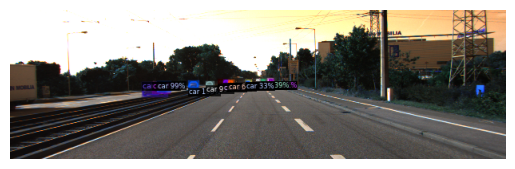

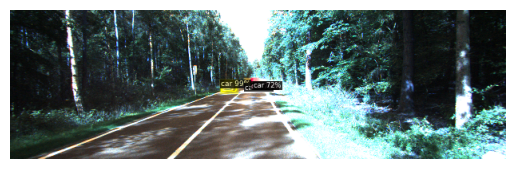

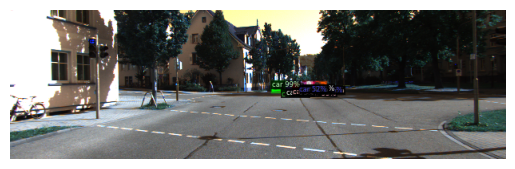

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
from detectron2.checkpoint import DetectionCheckpointer
import random
import cv2
import torch

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/Output_Final_Combined/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

predictor = DefaultPredictor(cfg)


evaluator = COCOEvaluator("kitti_val", cfg, False, output_dir="/content/drive/MyDrive/Colab Notebooks/training/inference")
val_loader = build_detection_test_loader(cfg, "kitti_val")

# Run inference and get results
results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(results)


# Visualize predictions on a few validation images
metadata = MetadataCatalog.get("kitti_val")
for d in random.sample(get_kitti_dicts(val_images, val_annotations), 3):  # Display 3 random images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()


[05/06 06:48:45 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[05/06 06:49:02 d2.evaluation.evaluator]: Inference done 11/1398. Dataloading: 0.0021 s/iter. Inference: 0.1496 s/iter. Eval: 0.0186 s/iter. Total: 0.1704 s/iter. ETA=0:03:56
[05/06 06:49:08 d2.evaluation.evaluator]: Inference done 42/1398. Dataloading: 0.0025 s/iter. Inference: 0.1473 s/iter. Eval: 0.0148 s/iter. Total: 0.1647 s/iter. ETA=0:03:43
[05/06 06:49:13 d2.evaluation.evaluator]: Inference done 72/1398. Dataloading: 0.0030 s/iter. Inference: 0.1493 s/iter. Eval: 0.0153 s/iter. Total: 0.1676 s/iter. ETA=0:03:42
[05/06 06:49:18 d2.evaluation.evaluator]: Inference done 103/1398. Dataloading: 0.0027 s/iter. Inference: 0.1487 s/iter. Eval: 0.0145 s/iter. Total: 0.1660 s/iter. ETA=0:03:35
[05/06 06:49:23 d2.evaluation.evaluator]: Inference done 134/1398. Dataloading: 0.0026 s/iter. Inference: 0.1489 s/iter. Eval: 0.0136 s/iter. Total: 0.1652 s/iter. ETA=0:03:28
[05/06 06:49:28 d2.evaluation.evaluator]: Inference done 163/1398. Dataloading: 0.0028 s/iter. Inference: 0.1505 s/iter. Ev

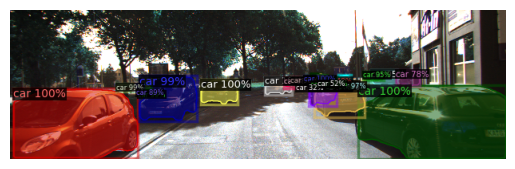

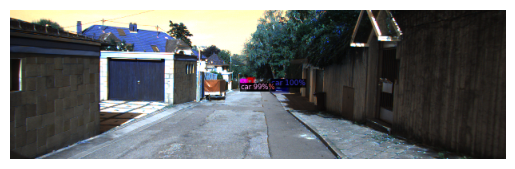

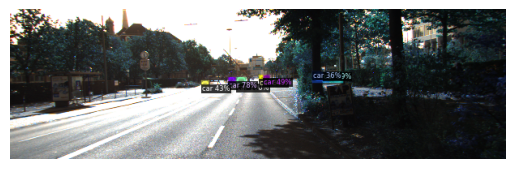

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
from detectron2.checkpoint import DetectionCheckpointer
import random
import cv2
import torch

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/Output_Final_Combined/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

predictor = DefaultPredictor(cfg)


evaluator = COCOEvaluator("kitti_val", cfg, False, output_dir="/content/drive/MyDrive/Colab Notebooks/training/inference")
val_loader = build_detection_test_loader(cfg, "kitti_val")

# Run inference and get results
results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(results)


# Visualize predictions on a few validation images
metadata = MetadataCatalog.get("kitti_val")
for d in random.sample(get_kitti_dicts(val_images, val_annotations), 3):  # Display 3 random images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()


In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
from detectron2.checkpoint import DetectionCheckpointer
import random
import cv2
import torch

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/output 7/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

predictor = DefaultPredictor(cfg)


evaluator = COCOEvaluator("merged_val2", cfg, False, output_dir="/content/drive/MyDrive/Colab Notebooks/training/inference")
val_loader = build_detection_test_loader(cfg, "merged_val2")

# Run inference and get results
results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(results)


# Visualize predictions on a few validation images
metadata = MetadataCatalog.get("merged_val2")
for d in random.sample(get_kitti_dicts(val_images, val_annotations), 3):  # Display 3 random images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()


[05/06 07:18:16 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

ValueError: shapes (8,2) and (8,2) not aligned: 2 (dim 1) != 8 (dim 0)

[03/14 11:36:58 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.11/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

[03/14 11:37:00 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/output 7/model_final.pth ...
WARNING [03/14 11:37:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/14 11:37:01 d2.evaluation.coco_evaluation]: Trying to convert 'kitti_val' to COCO format ...
WARNING [03/14 11:37:01 d2.data.datasets.coco]: Using previously cached COCO format annotations at '/content/drive/MyDrive/Colab Notebooks/training/inference/kitti_val_coco_format.json'. You need to clear the cache file if your dataset has been modified.
[03/14 11:37:04 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    car     | 13244        |
|            |              |
[03/14 11:37:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_ed

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[03/14 11:37:07 d2.evaluation.evaluator]: Inference done 11/1398. Dataloading: 0.0019 s/iter. Inference: 0.1450 s/iter. Eval: 0.0118 s/iter. Total: 0.1587 s/iter. ETA=0:03:40
[03/14 11:37:12 d2.evaluation.evaluator]: Inference done 39/1398. Dataloading: 0.0056 s/iter. Inference: 0.1507 s/iter. Eval: 0.0191 s/iter. Total: 0.1755 s/iter. ETA=0:03:58
[03/14 11:37:17 d2.evaluation.evaluator]: Inference done 71/1398. Dataloading: 0.0042 s/iter. Inference: 0.1478 s/iter. Eval: 0.0157 s/iter. Total: 0.1678 s/iter. ETA=0:03:42
[03/14 11:37:23 d2.evaluation.evaluator]: Inference done 102/1398. Dataloading: 0.0038 s/iter. Inference: 0.1478 s/iter. Eval: 0.0152 s/iter. Total: 0.1669 s/iter. ETA=0:03:36
[03/14 11:37:28 d2.evaluation.evaluator]: Inference done 127/1398. Dataloading: 0.0106 s/iter. Inference: 0.1486 s/iter. Eval: 0.0149 s/iter. Total: 0.1742 s/iter. ETA=0:03:41
[03/14 11:37:33 d2.evaluation.evaluator]: Inference done 159/1398. Dataloading: 0.0089 s/iter. Inference: 0.1483 s/iter. Ev

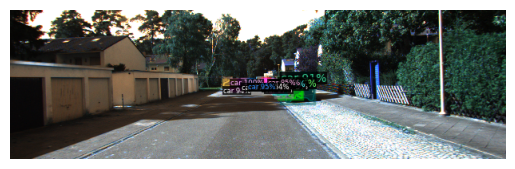

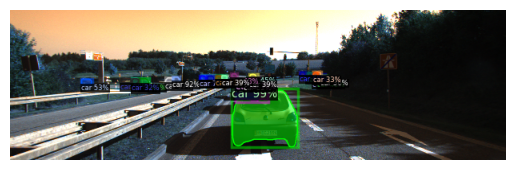

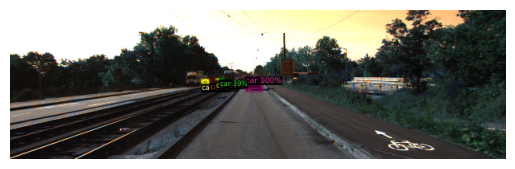

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
from detectron2.checkpoint import DetectionCheckpointer
import random
import cv2
import torch

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/output 7/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

predictor = DefaultPredictor(cfg)


evaluator = COCOEvaluator("kitti_val", cfg, False, output_dir="/content/drive/MyDrive/Colab Notebooks/training/inference")
val_loader = build_detection_test_loader(cfg, "kitti_val")

# Run inference and get results
results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(results)


# Visualize predictions on a few validation images
metadata = MetadataCatalog.get("kitti_val")
for d in random.sample(get_kitti_dicts(val_images, val_annotations), 3):  # Display 3 random images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()


[03/23 07:29:53 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[03/23 07:30:05 d2.evaluation.evaluator]: Inference done 11/1398. Dataloading: 0.0015 s/iter. Inference: 0.1438 s/iter. Eval: 0.0169 s/iter. Total: 0.1622 s/iter. ETA=0:03:44
[03/23 07:30:10 d2.evaluation.evaluator]: Inference done 39/1398. Dataloading: 0.0195 s/iter. Inference: 0.1423 s/iter. Eval: 0.0147 s/iter. Total: 0.1767 s/iter. ETA=0:04:00
[03/23 07:30:15 d2.evaluation.evaluator]: Inference done 64/1398. Dataloading: 0.0280 s/iter. Inference: 0.1446 s/iter. Eval: 0.0155 s/iter. Total: 0.1883 s/iter. ETA=0:04:11
[03/23 07:30:20 d2.evaluation.evaluator]: Inference done 88/1398. Dataloading: 0.0360 s/iter. Inference: 0.1446 s/iter. Eval: 0.0153 s/iter. Total: 0.1961 s/iter. ETA=0:04:16
[03/23 07:30:25 d2.evaluation.evaluator]: Inference done 117/1398. Dataloading: 0.0299 s/iter. Inference: 0.1458 s/iter. Eval: 0.0149 s/iter. Total: 0.1907 s/iter. ETA=0:04:04
[03/23 07:30:30 d2.evaluation.evaluator]: Inference done 141/1398. Dataloading: 0.0334 s/iter. Inference: 0.1460 s/iter. Eva

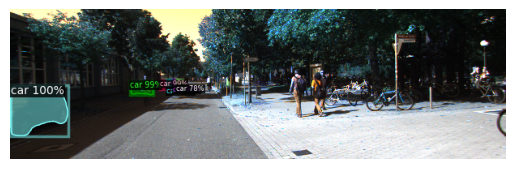

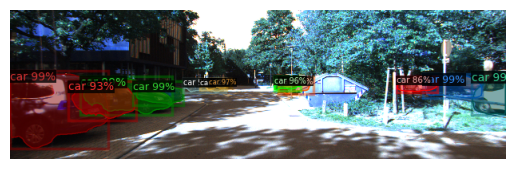

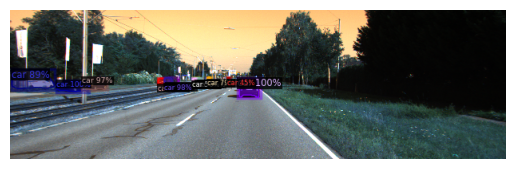

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
from detectron2.checkpoint import DetectionCheckpointer
import random
import cv2
import torch

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/output 7/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

predictor = DefaultPredictor(cfg)


evaluator = COCOEvaluator("kitti_val", cfg, False, output_dir="/content/drive/MyDrive/Colab Notebooks/training/inference")
val_loader = build_detection_test_loader(cfg, "kitti_val")

# Run inference and get results
results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(results)


# Visualize predictions on a few validation images
metadata = MetadataCatalog.get("kitti_val")
for d in random.sample(get_kitti_dicts(val_images, val_annotations), 3):  # Display 3 random images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()


In [ ]:
for d in random.sample(get_kitti_dicts(val_images, val_annotations), 3):  # Display 3 random images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()

NameError: name 'random' is not defined

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
from detectron2.checkpoint import DetectionCheckpointer
import random
import cv2
import torch

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/output 7/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

[03/23 07:42:07 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2): Sequential(
        (0): BottleneckBlock

In [ ]:
metadata = MetadataCatalog.get("merged_val2")
for d in random.sample(get_kitti_dicts(val_images, val_annotations), 3):  # Display 3 random images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()

NameError: name 'get_kitti_dicts' is not defined

In [ ]:
import torch
import cv2
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt

predictor = DefaultPredictor(cfg)

def infer_and_visualize(image_path):
    img = cv2.imread(image_path)

    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get("merged_train2"), scale=0.8)
    # print(f'output', outputs["instances"][0])
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    cv2_imshow(out.get_image()[:, :, ::-1])
    cv2.waitKey(0)
    cv2.destroyAllWindows()


[03/23 07:42:24 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/output 7/model_final.pth ...


In [ ]:
image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/cars5.png"
# image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/test0.jpg"
infer_and_visualize(image_path)

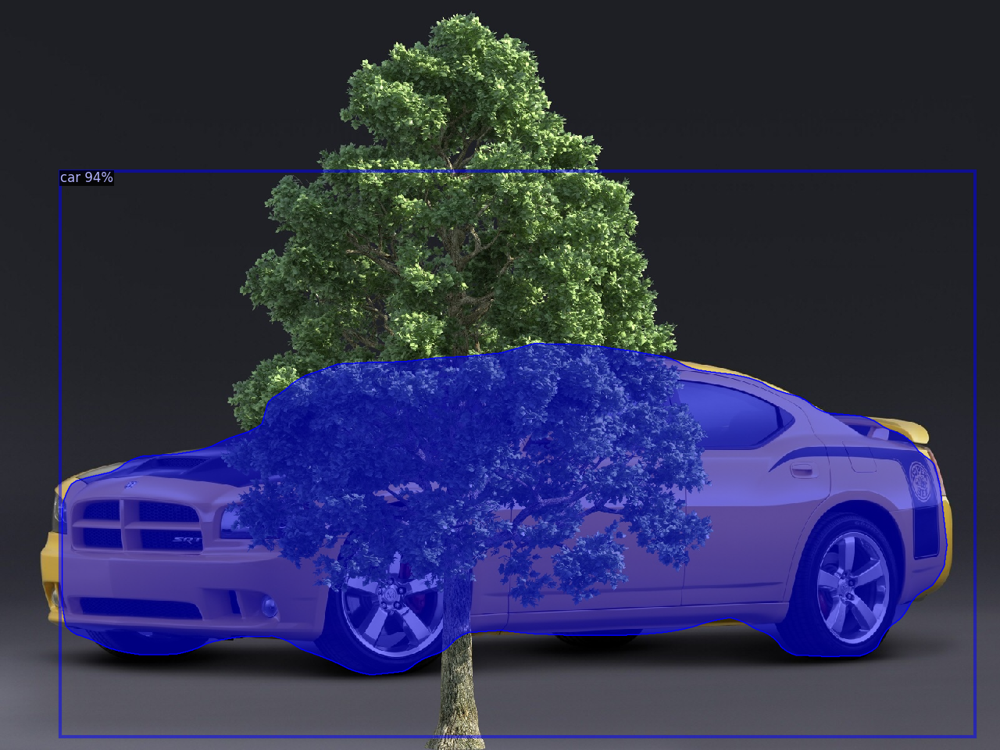

In [ ]:
image_path = "/content/00054.jpg"
infer_and_visualize(image_path)

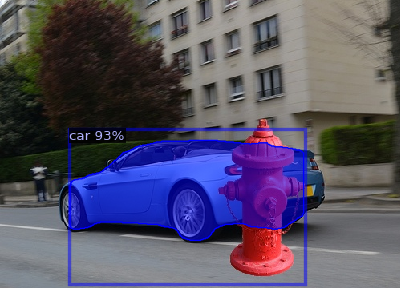

In [ ]:
# image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/cars5.png"
image_path = "/content/00065.jpg"
infer_and_visualize(image_path)

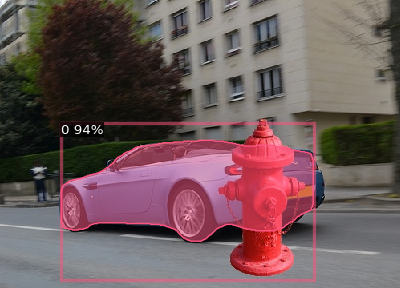

In [ ]:
# image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/cars5.png"
image_path = "/content/00065.jpg"
infer_and_visualize(image_path)

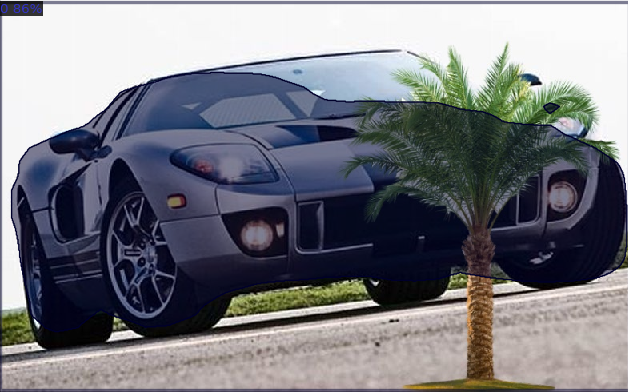

In [ ]:
# image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/cars5.png"
image_path = "/content/00094.jpg"
infer_and_visualize(image_path)

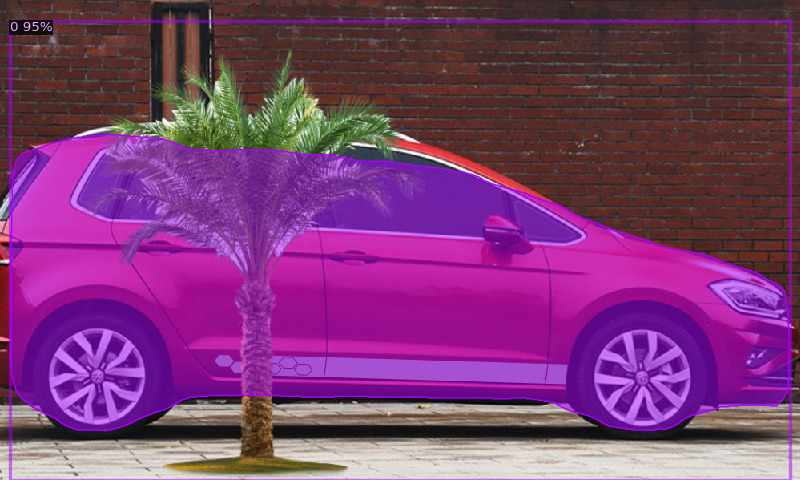

In [ ]:
image_path = "/content/Haa04c90142df4a01829fd6d84b7b3347H.png"
infer_and_visualize(image_path)

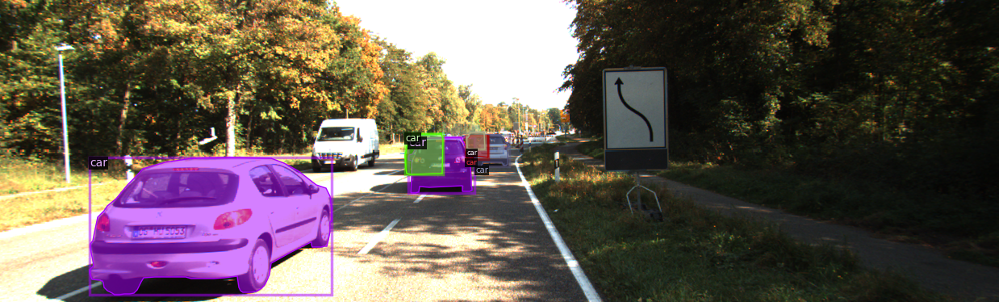

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
metadata = MetadataCatalog.get("kitti_train")
for d in random.sample(train_dset, 1):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

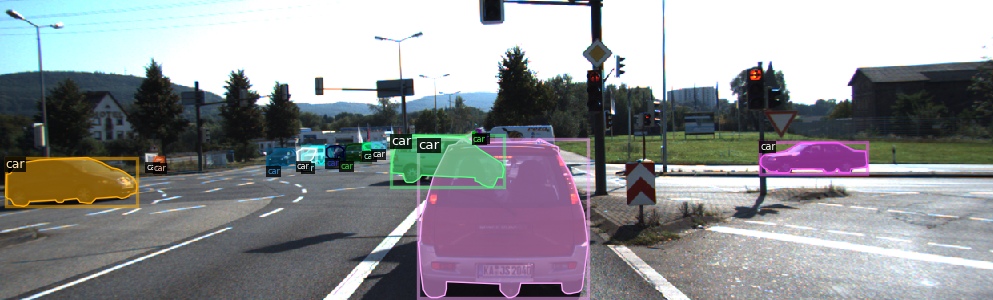

In [ ]:
for data in train_dset:
    if "001836.png" in data["file_name"]:
        img = cv2.imread(data["file_name"])
        visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.8)
        vis = visualizer.draw_dataset_dict(data)

        # Display the image
        cv2_imshow(vis.get_image()[:, :, ::-1])
        break

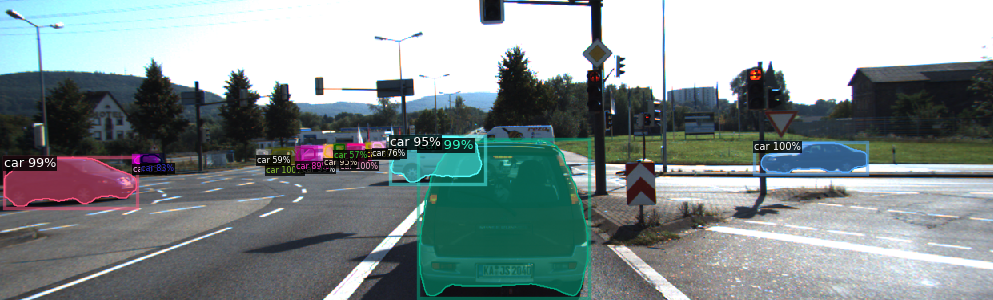

In [ ]:
image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/001836.png"
infer_and_visualize(image_path)

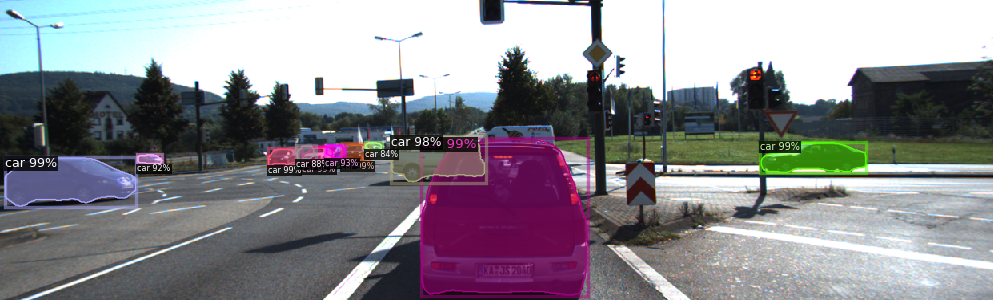

In [ ]:
image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/001836.png"
infer_and_visualize(image_path)

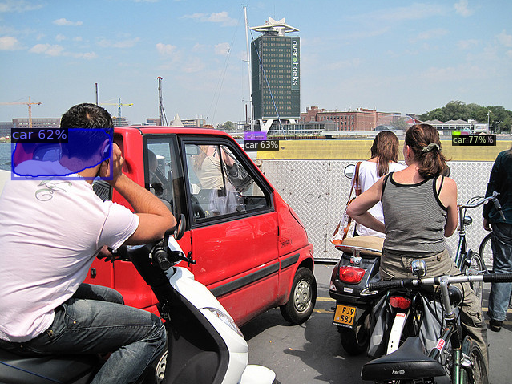

In [ ]:
image_path = "/content/car.jpg"
infer_and_visualize(image_path)

In [ ]:
import os
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

# Check if GPU is available, and set to "cuda" to utilize GPU
cfg = get_cfg()

cfg.OUTPUT_DIR = "/content/drive/MyDrive/Colab Notebooks/output"

cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.DATASETS.TRAIN = ("kitti_train",)
cfg.DATASETS.TEST = ("kitti_val",)
cfg.DATALOADER.NUM_WORKERS = 2


cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("Cityscapes/mask_rcnn_R_50_FPN.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2  # Increase batch size if memory allows (4 is often safe for Colab's GPU)
cfg.SOLVER.BASE_LR = 0.001  # Slightly higher learning rate for quicker training
cfg.SOLVER.MAX_ITER = 3000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512  # Increase batch size per image for quicker optimization
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # Only car category

# Set a shorter checkpoint period for faster resume if interrupted
cfg.SOLVER.CHECKPOINT_PERIOD = 500  # Saves model every 500 iterations

# Create output directory if it doesn't exist
# os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# Initialize trainer
trainer = DefaultTrainer(cfg)

# Set resume to True to load the latest checkpoint and continue training
trainer.resume_or_load(resume=True)

# Start training
trainer.train()


[11/13 10:33:15 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[11/13 10:34:23 d2.engine.train_loop]: Starting training from iteration 0
[11/13 10:34:38 d2.utils.events]:  eta: 0:35:52  iter: 19  total_loss: 2.283  loss_cls: 0.6145  loss_box_reg: 0.6323  loss_mask: 0.6964  loss_rpn_cls: 0.09224  loss_rpn_loc: 0.09934    time: 0.7238  last_time: 0.7003  data_time: 0.0546  last_data_time: 0.0070   lr: 1.9981e-05  max_mem: 9111M
[11/13 10:34:53 d2.utils.events]:  eta: 0:35:38  iter: 39  total_loss: 1.886  loss_cls: 0.5476  loss_box_reg: 0.5462  loss_mask: 0.6743  loss_rpn_cls: 0.06062  loss_rpn_loc: 0.06368    time: 0.7223  last_time: 0.6798  data_time: 0.0128  last_data_time: 0.0074   lr: 3.9961e-05  max_mem: 9111M
[11/13 10:35:08 d2.utils.events]:  eta: 0:35:36  iter: 59  total_loss: 1.987  loss_cls: 0.4817  loss_box_reg: 0.6887  loss_mask: 0.6433  loss_rpn_cls: 0.0374  loss_rpn_loc: 0.1125    time: 0.7268  last_time: 0.7513  data_time: 0.0104  last_data_time: 0.0068   lr: 5.9941e-05  max_mem: 9111M
[11/13 10:35:23 d2.utils.events]:  eta: 0:35:35  

In [ ]:
# from google.colab.patches import cv2_imshow

[11/17 10:49:34 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/output/model_final.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

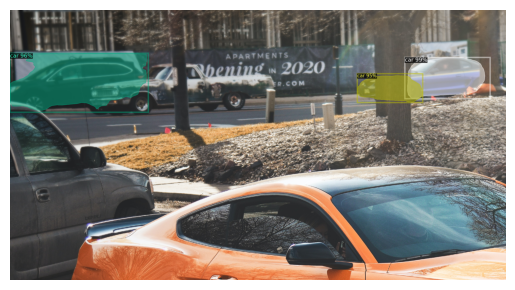

In [ ]:
import torch
import cv2
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt

# Set up the configuration for inference
cfg = get_cfg()
cfg.OUTPUT_DIR = "/content/drive/MyDrive/Colab Notebooks/output"
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set a threshold for prediction confidence
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # Path to the trained model weights
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # Set to 1 for only car category

# Initialize the predictor
predictor = DefaultPredictor(cfg)

# Function to run inference on a single image and visualize the result
def infer_and_visualize(image_path):
    # Load the image
    img = cv2.imread(image_path)

    # Run inference
    outputs = predictor(img)

    # Visualize predictions
    v = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get("kitti_train"), scale=0.8)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Show the output image
    cv2_imshow(out.get_image()[:, :, ::-1])
    cv2.waitKey(0)
    cv2.destroyAllWindows()

# Example usage
image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/cars5.png"
# image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/test0.jpg"
infer_and_visualize(image_path)


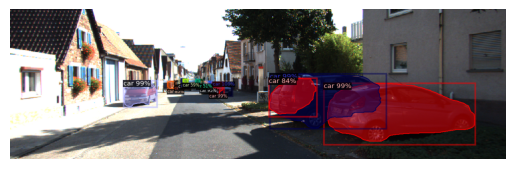

In [ ]:
image_path = "/content/cars4.png"
infer_and_visualize(image_path)

In [ ]:
test_ann = val_annotations[:100]
test_img = val_images[:100]
DatasetCatalog.register("kitti_test2", lambda: get_kitti_dicts(test_img, test_ann))
MetadataCatalog.get("kitti_test2").set(thing_classes=["car"])

namespace(name='kitti_test2',
          json_file='/content/drive/MyDrive/Colab Notebooks/training/inference/kitti_test2_coco_format.json',
          thing_classes=['car'])

[11/16 03:30:28 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[11/16 03:30:36 d2.evaluation.evaluator]: Inference done 11/100. Dataloading: 0.0020 s/iter. Inference: 0.1403 s/iter. Eval: 0.0153 s/iter. Total: 0.1576 s/iter. ETA=0:00:14
[11/16 03:30:41 d2.evaluation.evaluator]: Inference done 44/100. Dataloading: 0.0031 s/iter. Inference: 0.1353 s/iter. Eval: 0.0151 s/iter. Total: 0.1536 s/iter. ETA=0:00:08
[11/16 03:30:46 d2.evaluation.evaluator]: Inference done 76/100. Dataloading: 0.0034 s/iter. Inference: 0.1362 s/iter. Eval: 0.0165 s/iter. Total: 0.1562 s/iter. ETA=0:00:03
[11/16 03:30:50 d2.evaluation.evaluator]: Total inference time: 0:00:15.567838 (0.163872 s / iter per device, on 1 devices)
[11/16 03:30:50 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:13 (0.138662 s / iter per device, on 1 devices)
[11/16 03:30:51 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[11/16 03:30:51 d2.evaluation.coco_evaluation]: Saving results to /content/drive/MyDrive/Colab Notebooks/training/inference/coco_instances

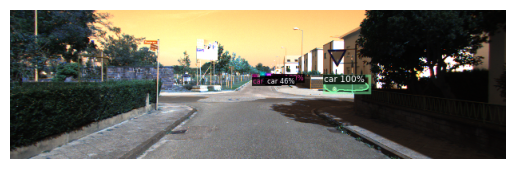

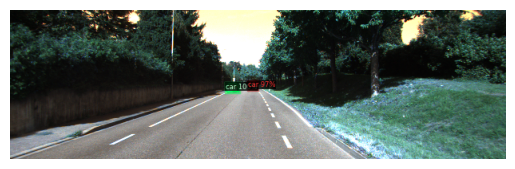

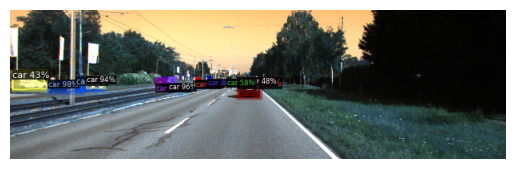

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
from detectron2.checkpoint import DetectionCheckpointer
import random
import cv2
import torch

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/output/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

predictor = DefaultPredictor(cfg)


evaluator = COCOEvaluator("kitti_test2", cfg, False, output_dir="/content/drive/MyDrive/Colab Notebooks/training/inference")
val_loader = build_detection_test_loader(cfg, "kitti_test2")

# Run inference and get results
results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(results)


# Visualize predictions on a few validation images
metadata = MetadataCatalog.get("kitti_test2")
for d in random.sample(get_kitti_dicts(test_img, test_ann), 3):  # Display 3 random images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()


[11/16 03:33:50 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

[11/16 03:33:51 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/output/model_final.pth ...
WARNING [11/16 03:33:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[11/16 03:33:52 d2.evaluation.coco_evaluation]: Trying to convert 'kitti_val' to COCO format ...
WARNING [11/16 03:33:52 d2.data.datasets.coco]: Using previously cached COCO format annotations at '/content/drive/MyDrive/Colab Notebooks/training/inference/kitti_val_coco_format.json'. You need to clear the cache file if your dataset has been modified.
[11/16 03:33:56 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    car     | 13244        |
|            |              |
[11/16 03:33:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[11/16 03:33:59 d2.evaluation.evaluator]: Inference done 11/1398. Dataloading: 0.0047 s/iter. Inference: 0.1438 s/iter. Eval: 0.0176 s/iter. Total: 0.1661 s/iter. ETA=0:03:50
[11/16 03:34:04 d2.evaluation.evaluator]: Inference done 43/1398. Dataloading: 0.0034 s/iter. Inference: 0.1406 s/iter. Eval: 0.0153 s/iter. Total: 0.1594 s/iter. ETA=0:03:36
[11/16 03:34:09 d2.evaluation.evaluator]: Inference done 77/1398. Dataloading: 0.0030 s/iter. Inference: 0.1373 s/iter. Eval: 0.0138 s/iter. Total: 0.1543 s/iter. ETA=0:03:23
[11/16 03:34:15 d2.evaluation.evaluator]: Inference done 106/1398. Dataloading: 0.0036 s/iter. Inference: 0.1414 s/iter. Eval: 0.0180 s/iter. Total: 0.1631 s/iter. ETA=0:03:30
[11/16 03:34:20 d2.evaluation.evaluator]: Inference done 134/1398. Dataloading: 0.0042 s/iter. Inference: 0.1430 s/iter. Eval: 0.0196 s/iter. Total: 0.1670 s/iter. ETA=0:03:31
[11/16 03:34:25 d2.evaluation.evaluator]: Inference done 167/1398. Dataloading: 0.0040 s/iter. Inference: 0.1417 s/iter. Ev

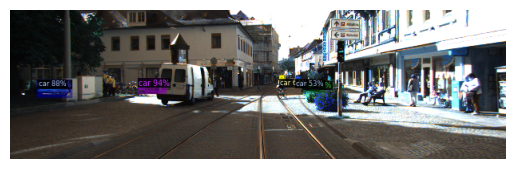

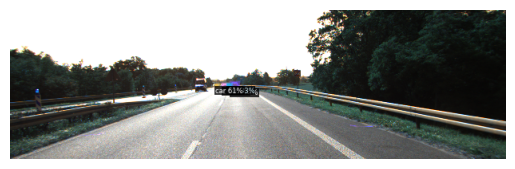

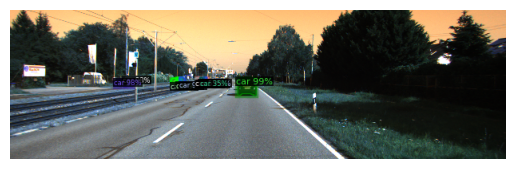

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
from detectron2.checkpoint import DetectionCheckpointer
import random
import cv2
import torch

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/output/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

predictor = DefaultPredictor(cfg)


evaluator = COCOEvaluator("kitti_val", cfg, False, output_dir="/content/drive/MyDrive/Colab Notebooks/training/inference")
val_loader = build_detection_test_loader(cfg, "kitti_val")

# Run inference and get results
results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(results)


# Visualize predictions on a few validation images
metadata = MetadataCatalog.get("kitti_val")
for d in random.sample(get_kitti_dicts(val_images, val_annotations), 3):  # Display 3 random images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.axis("off")
    plt.show()


[11/15 17:49:27 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

[11/15 17:49:28 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/output/model_final.pth ...
[11/15 17:49:29 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/output/model_final.pth ...


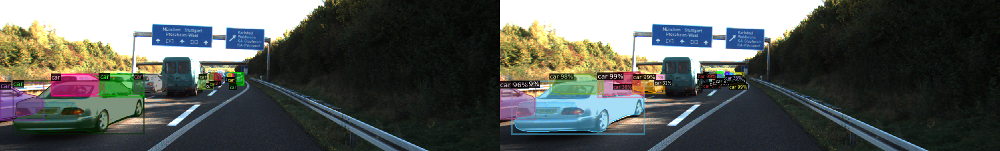

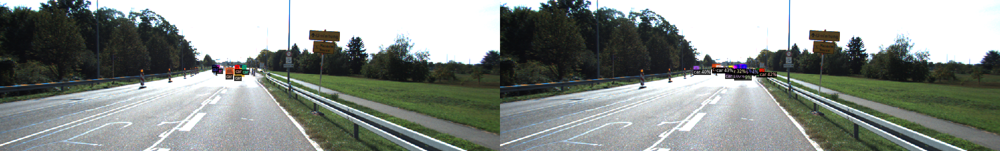

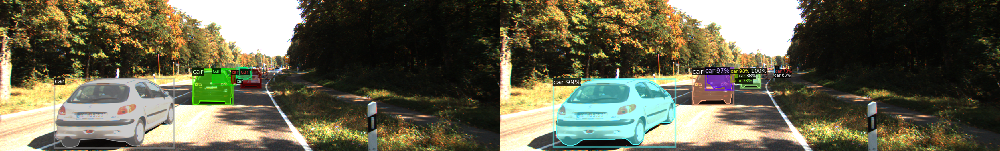

In [ ]:
import random
import cv2
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import torch
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.engine import DefaultPredictor

val_dset = get_kitti_dicts(val_images, val_annotations)
metadata = MetadataCatalog.get("kitti_val")


cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/output/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

predictor = DefaultPredictor(cfg)

for sample in random.sample(val_dset, 3):
    image = cv2.imread(sample["file_name"])

    visualizer_gt = Visualizer(image[:, :, ::-1], metadata=metadata, scale=0.8)
    vis_gt = visualizer_gt.draw_dataset_dict(sample)

    outputs = predictor(image)

    visualizer_pred = Visualizer(image[:, :, ::-1], metadata=metadata, scale=0.8)
    vis_pred = visualizer_pred.draw_instance_predictions(outputs["instances"].to("cpu"))

    combined_vis = cv2.hconcat([vis_gt.get_image()[:, :, ::-1], vis_pred.get_image()[:, :, ::-1]])
    cv2_imshow(combined_vis)
    cv2.waitKey(0)
cv2.destroyAllWindows()

[11/15 17:53:38 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

[11/15 17:53:40 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/output/model_final.pth ...


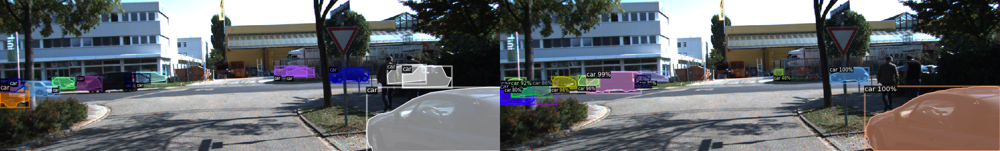

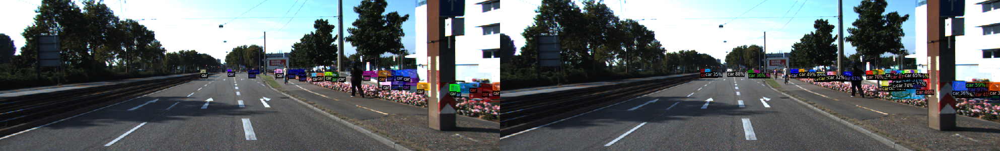

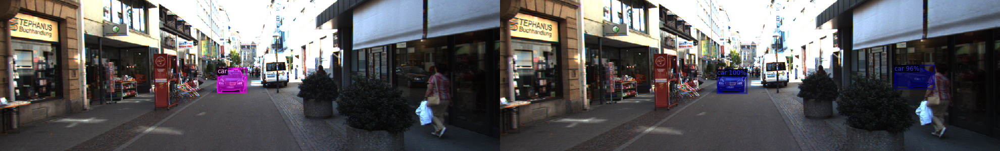

In [ ]:
import random
import cv2
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import torch
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.engine import DefaultPredictor
from google.colab.patches import cv2_imshow

val_dset = get_kitti_dicts(val_images, val_annotations)
metadata = MetadataCatalog.get("kitti_val")

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))  # Ensure correct config file path here
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/output/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()

predictor = DefaultPredictor(cfg)

for sample in random.sample(val_dset, 3):
    image = cv2.imread(sample["file_name"])

    visualizer_gt = Visualizer(image[:, :, ::-1], metadata=metadata, scale=0.8)
    vis_gt = visualizer_gt.draw_dataset_dict(sample)

    outputs = predictor(image)

    instances = outputs["instances"].to("cpu")

    if outputs["instances"].has("pred_boxes"):
        visualizer_pred = Visualizer(image[:, :, ::-1], metadata=metadata, scale=0.8)
        vis_pred = visualizer_pred.draw_instance_predictions(outputs["instances"].to("cpu"))

        combined_vis = cv2.hconcat([vis_gt.get_image()[:, :, ::-1], vis_pred.get_image()[:, :, ::-1]])
        cv2_imshow(combined_vis)
    else:
        print("No predictions found for this image.")

cv2.destroyAllWindows()


[11/15 17:55:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

[11/15 17:55:01 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/output/model_final.pth ...


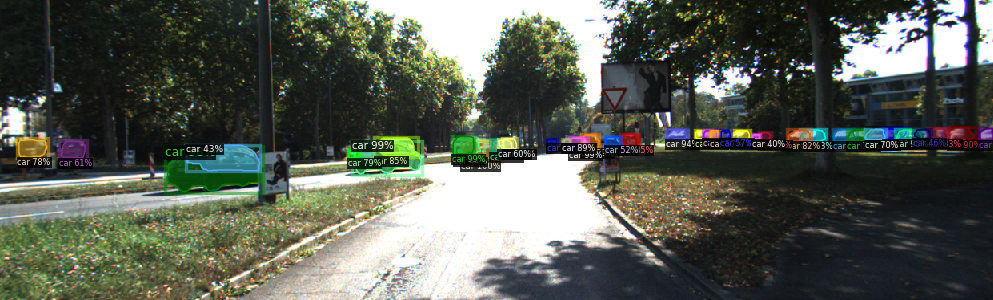

IoU score: 0.0712


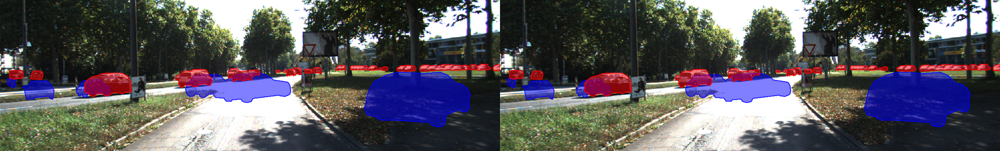

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from detectron2.utils.visualizer import Visualizer
from detectron2.engine import DefaultPredictor
from detectron2.data import MetadataCatalog
from detectron2.config import get_cfg
from detectron2 import model_zoo
from sklearn.metrics import jaccard_score

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Cityscapes/mask_rcnn_R_50_FPN.yaml"))
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab Notebooks/output/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3  # Adjust score threshold
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
model = DefaultTrainer.build_model(cfg)

checkpointer = DetectionCheckpointer(model)
checkpointer.load(cfg.MODEL.WEIGHTS)
model.eval()


# Initialize the predictor
predictor = DefaultPredictor(cfg)

# Path to validation JSON file
json_path = r"/content/drive/MyDrive/Colab Notebooks/training/update_train_2020.json"
with open(json_path) as f:
    kins_data = json.load(f)

def get_ground_truth_mask(image_id, height, width):
    # padded_image_id = str(image_id).zfill(6)
    """Generate ground truth mask for a specific image from JSON annotations."""
    mask = np.zeros((height, width), dtype=np.uint8)
    for annotation in kins_data['annotations']:
        if annotation['image_id'] == image_id and annotation['category_id'] == 4:  # category_id 4 for "car"
            for seg in annotation["a_segm"]:
                poly = np.array(seg, dtype=np.int32).reshape((-1, 2))
                cv2.fillPoly(mask, [poly], 255)  # Fill polygon for car annotations
    return mask

def infer_and_evaluate(image_path, image_id):
    """Run inference on the image, visualize, and calculate IoU with ground truth."""
    # Load the image
    img = cv2.imread(image_path)
    height, width = img.shape[:2]

    # Run model prediction
    outputs = predictor(img)
    instances = outputs["instances"].to("cpu")

    v = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get("kitti_train"), scale=0.8)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Show the output image
    cv2_imshow(out.get_image()[:, :, ::-1])
    cv2.waitKey(0)
    cv2.destroyAllWindows()

    # Generate ground truth mask from annotations
    gt_mask = get_ground_truth_mask(image_id, height, width)

    # Initialize prediction mask (same size as image)
    pred_mask = np.zeros((height, width), dtype=np.uint8)

    # Extract the predicted masks and combine into one mask for IoU calculation
    for mask in instances.pred_masks:
        pred_mask = np.maximum(pred_mask, mask.numpy().astype(np.uint8) * 255)

    # Calculate IoU
    intersection = np.logical_and(gt_mask, pred_mask).sum()
    union = np.logical_or(gt_mask, pred_mask).sum()
    iou = intersection / union if union > 0 else 0.0
    print(f"IoU score: {iou:.4f}")

    # Visualize ground truth vs prediction
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get("kitti_val"), scale=0.8)
    vis_gt = visualizer.draw_binary_mask(gt_mask, color="blue", alpha=0.5)
    vis_pred = visualizer.draw_binary_mask(pred_mask, color="red", alpha=0.5)

    combined_vis = cv2.hconcat([vis_gt.get_image()[:, :, ::-1], vis_pred.get_image()[:, :, ::-1]])
    cv2_imshow(combined_vis)  # Show GT (blue) vs Prediction (red)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

# Example usage
image_path = "/content/drive/MyDrive/Colab Notebooks/training/testing/000131.png"
image_id = 131  # Replace with the actual image_id from validation set
infer_and_evaluate(image_path, image_id)
